### Fracture processing for Tala

In [12]:
from fractureimport import PolyFracFile
import pprint
import numpy as np
import shapely.geometry as sg
import shapely.ops as so

In [2]:
input_poly_file = "..\\..\\data\\measurements.poly"
fracs = PolyFracFile(input_poly_file)

c:\Users\simold\Documents\git\geoseer\src\geoseer\fractureimport.py:106: ShapelyDeprecationWarning: STRtree will be changed in 2.0.0 and will not be compatible with versions < 2.
  self.search_tree = strtree.STRtree(self.reprojected_lines)
c:\ProgramData\Miniconda3\envs\geo22py311\Lib\site-packages\shapely\strtree.py:118: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  self._geoms = list(geoms)
c:\ProgramData\Miniconda3\envs\geo22py311\Lib\site-packages\shapely\strtree.py:118: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  self._geoms = list(geoms)


In [3]:
# This shows the contents of the 'fracs' object just created
# Items include both methods and properties

print(dir(fracs))

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'coord_list', 'dip_from_ij_arr', 'file_name', 'file_path', 'find_min_x', 'get_data_long_axis', 'import_data', 'long_axis_angle', 'make_linestring_list', 'make_search_tree', 'original_extent', 'original_lines', 'plot_xz_linelist', 'print_colorbar', 'read_coordinates_from_xyz_file', 'reproject_to_local_grid', 'reprojected_lines', 'rgba_col_val', 'rotated_extent', 'search_fractures_x_window', 'search_tree', 'translated_extent', 'xy_to_fracpaq', 'xz_to_fracpaq']


In [4]:
# All individual fracture lines, after reprojection to the local grid
fracs.reprojected_lines

In [5]:
print(fracs.original_extent)
print(fracs.rotated_extent)
print(fracs.translated_extent)

(560418.7286002, 6322619.3938, 560576.3859869, 6323620.308894)
[559991.4155618437, 6323115.165923015, 561004.152836455, 6323125.099742986]
(0.0, 0.0, 1012.7372746113688, 9.933819971047342)


In [6]:
# make point cloud

# data = [x.xy for x in fracs.reprojected_lines.geoms[0:3]]

In [7]:
window_min_x = 10
window_max_x = 20

active_lines = fracs.search_fractures_x_window(window_min_x, window_max_x)


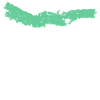

In [8]:
active_lines

In [ ]:
line_properties = {}
for line, idx in enumerate(active_lines):
    line_properties[idx] = {"centroid": centroid(line),
                            "length": length(line),
                        }
    line.get


In [11]:
so.get_point(active_lines.geoms[1], 0)

NameError: name 'get_point' is not defined

In [ ]:
all_lines_reproj = fracs.reprojected_lines

window_x_min = 10
window_x_max = 15

active_lines = []
for line in all_lines_reproj:
    x_list, y_list = line.xy
    line_x_max = np.max(x_list)
    line_x_min = np.min(x_list)
    # if line exists in search window do something
    if line_x_min <= window_x_max and line_x_max >= window_x_min:
        active_lines.append(line)

active_lines = sg.MultiLineString(active_lines)
active_lines

In [ ]:
len(list(active_lines.geoms))
